# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from datetime import date
import os
import pickle
import sys

import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
import models

2024-08-08 22:21:43.595107: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-08 22:21:43.617315: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-08 22:21:43.617338: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-08 22:21:43.618175: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-08 22:21:43.622696: I tensorflow/core/platform/cpu_feature_guar

## Open Data

In [3]:
resolution = 48

start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]

data_files = []
label_files = []
# for elem in os.listdir("C:/Users/raulp/Documents/Master/TFM/minig-detector-tfm/data/training_data/48_px"):
for elem in os.listdir("../data/training_data/48_px"):
    if "_labels.pkl" in elem:
        label_files.append(elem)
    elif ".pkl" in elem:
        data_files.append(elem)


patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/15 [00:00<?, ?it/s]

2644 samples loaded
551 positive samples
2093 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

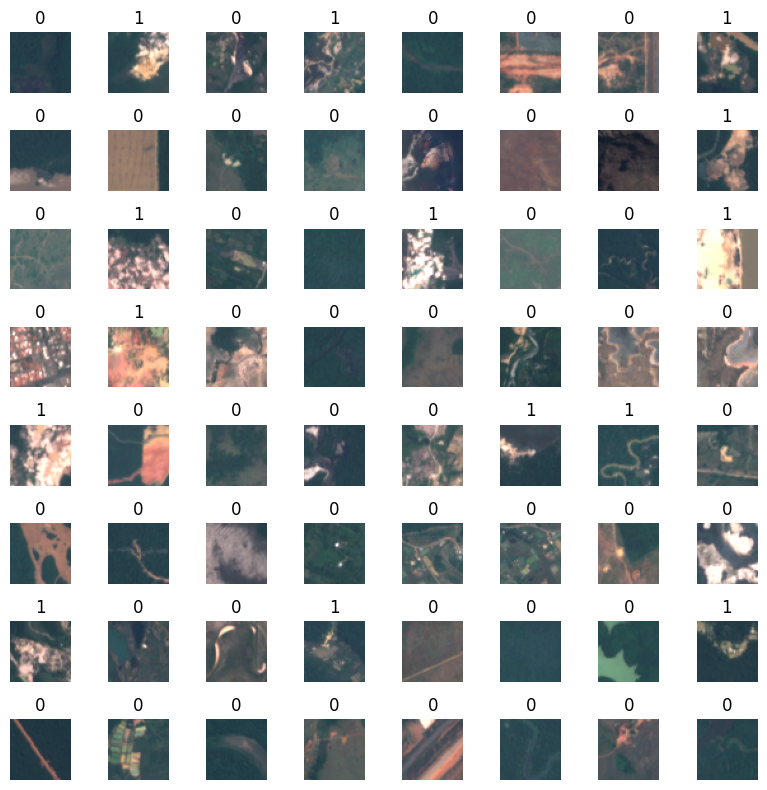

In [4]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [5]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7198333333333333].


100.0% of data below brightness limit


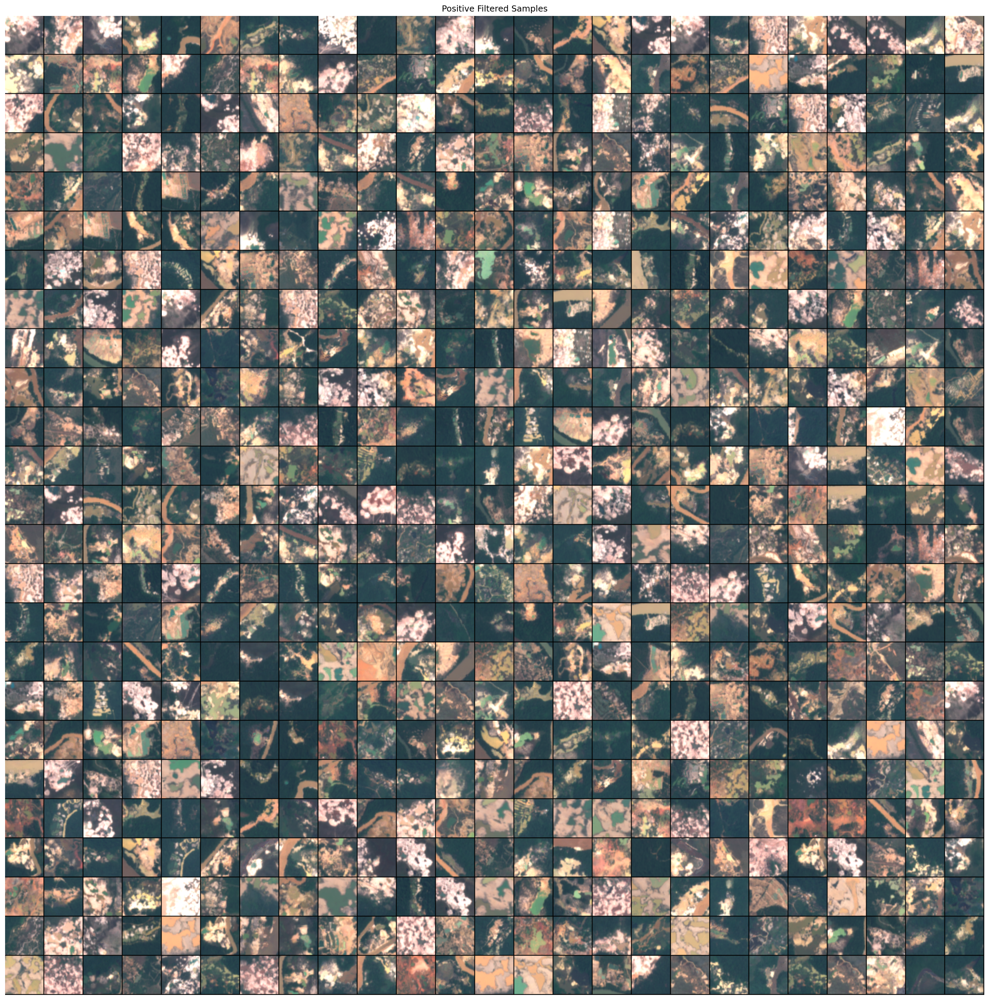

In [6]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..2.248].


100.0% of data below brightness limit


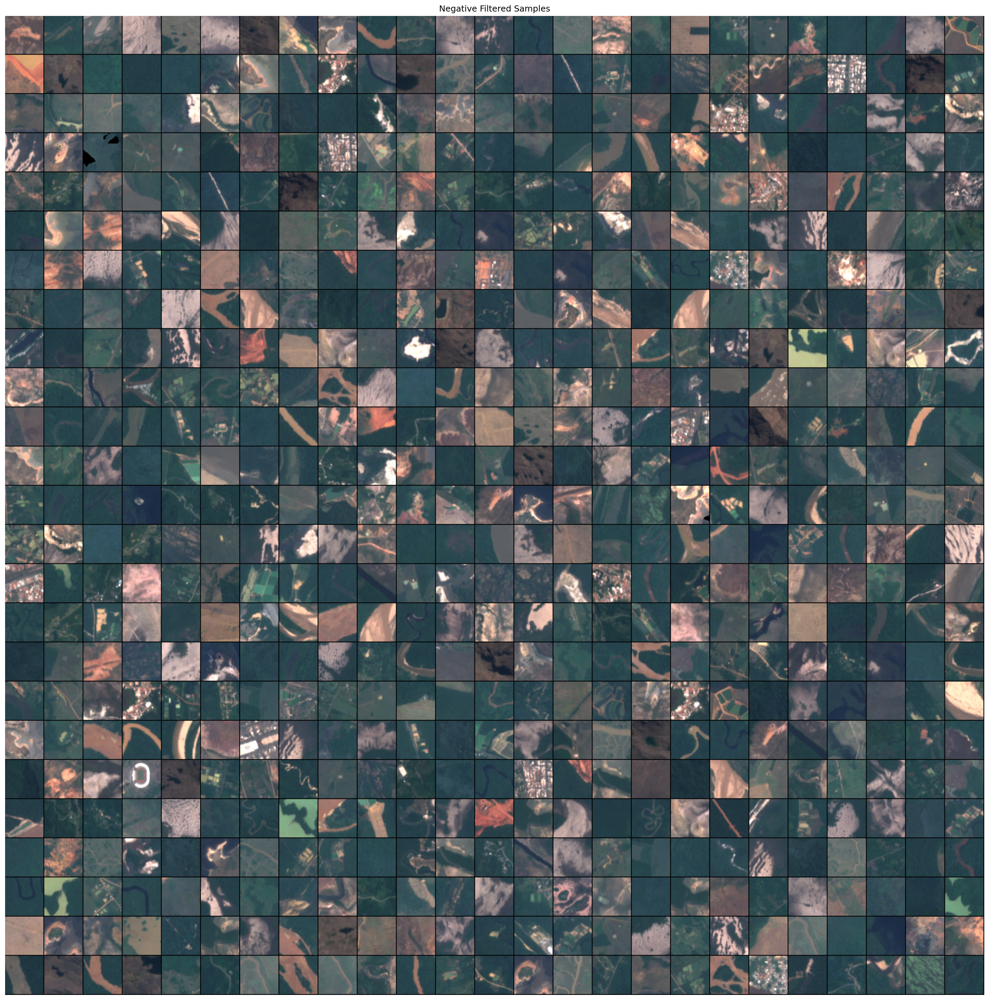

In [7]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [8]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

## Data Augmentation
Augmentation is important to help the model train. These are parameters that generally worked, but there is certainly room for improvement.

Plot a set of images to give an example of augmented images

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2644, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

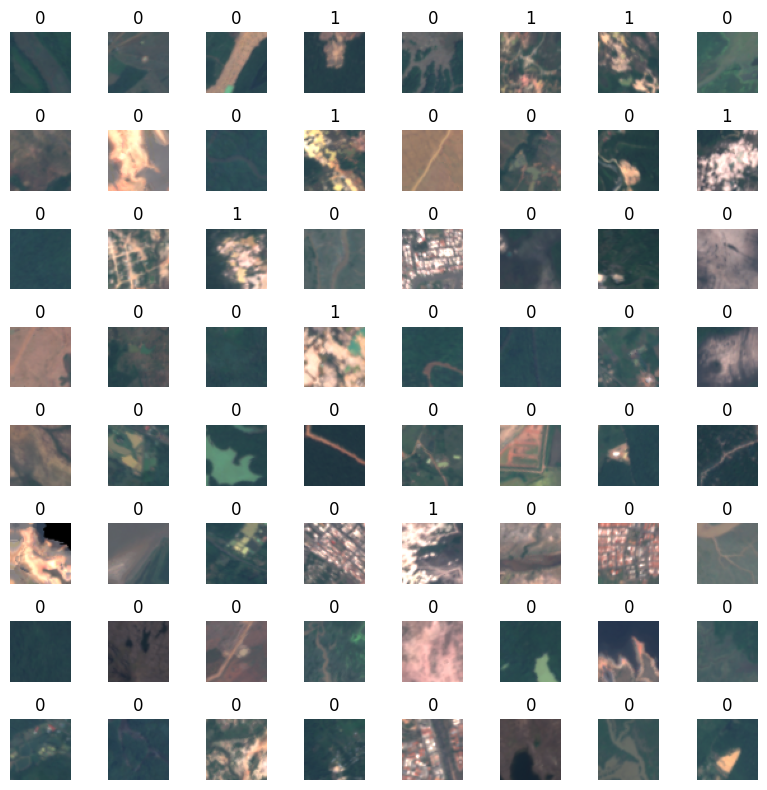

In [9]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [10]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

## Train Ensemble

In [11]:
version_number = f"3.7"
keras.utils.set_random_seed(123)
x_train, x_test, y_train, y_test = train_test_split(
    x_norm, y, test_size=0.30, random_state=123
)

In [12]:
scratch_original_model = models.scratch_original_model(x_train.shape[1:])
scratch_modified_model = models.scratch_modified_model(x_train.shape[1:])
vgg16 = models.vgg_16_model(x_train.shape[1:])
mobile_net = models.mobilenet_model(x_train.shape[1:])

2024-08-08 22:21:54.882863: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-08 22:21:54.905619: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-08 22:21:54.905652: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-08 22:21:54.907863: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-08 22:21:54.907889: I external/local_xla/xla/stream_executor

In [13]:
train_accuracy = []
test_accuracy = []

batch_size = 32
epochs = 160

# add a weighted loss
class_weight = {0: 1, 1: 1}

In [14]:
scratch_original_model_results = scratch_original_model.fit(
        datagen.flow(x_train, y_train),
        batch_size=batch_size,
        epochs=epochs,
        validation_data=(x_test, y_test),
        verbose=1,
        shuffle=True,
        class_weight=class_weight,
    )

Epoch 1/160


/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1850, 48, 48, 12) (12 channels).
  warnings.warn(
2024-08-08 22:21:56.924246: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2024-08-08 22:21:56.985995: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-08-08 22:21:57.203395: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-08-08 22:21:57.767134: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f05704b2150 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-08-08 22:21:57.767180: I exte

58/58 [==============================] - 4s 20ms/step - loss: 0.5979 - acc: 0.7589 - val_loss: 0.5452 - val_acc: 0.7922
Epoch 2/160
58/58 [==============================] - 2s 27ms/step - loss: 0.5408 - acc: 0.7892 - val_loss: 0.5025 - val_acc: 0.7922
Epoch 3/160
58/58 [==============================] - 2s 28ms/step - loss: 0.5162 - acc: 0.7908 - val_loss: 0.4916 - val_acc: 0.7922
Epoch 4/160
58/58 [==============================] - 2s 28ms/step - loss: 0.4995 - acc: 0.7903 - val_loss: 0.4128 - val_acc: 0.7922
Epoch 5/160
58/58 [==============================] - 2s 28ms/step - loss: 0.4464 - acc: 0.7914 - val_loss: 0.3756 - val_acc: 0.7922
Epoch 6/160
58/58 [==============================] - 2s 29ms/step - loss: 0.4059 - acc: 0.7995 - val_loss: 0.3373 - val_acc: 0.8564
Epoch 7/160
58/58 [==============================] - 2s 29ms/step - loss: 0.4069 - acc: 0.8108 - val_loss: 0.3888 - val_acc: 0.8564
Epoch 8/160
58/58 [==============================] - 2s 29ms/step - loss: 0.3931 - acc: 

In [15]:
scratch_modified_model_results = scratch_modified_model.fit(
    datagen.flow(x_train, y_train),
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(x_test, y_test),
    verbose=1,
    shuffle=True,
    callbacks=dl_utils.define_callbacks("model_scratch_modified_"),
    class_weight=class_weight,
)

current_date = date.today()
model_name = f"{resolution}px_v{version_number}_model_fine_tunning_mobile_net_{current_date.isoformat()}"

# assert not os.path.exists('../models/' + model_name + '.h5'), f"Model of name {model_name} already exists"
scratch_modified_model.save(f"../models/{model_name}.h5")

Epoch 1/160


2024-08-08 22:26:29.298738: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


56/58 [===========================>..] - ETA: 0s - loss: 0.5336 - acc: 0.7889
Epoch 1: val_loss improved from inf to 0.56680, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
58/58 [==============================] - 5s 33ms/step - loss: 0.5317 - acc: 0.7897 - val_loss: 0.5668 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
58/58 [==============================] - ETA: 0s - loss: 0.4832 - acc: 0.7914
Epoch 2: val_loss improved from 0.56680 to 0.55871, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
58/58 [==============================] - 2s 28ms/step - loss: 0.4832 - acc: 0.7914 - val_loss: 0.5587 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 3/160
56/58 [===========================>..] - ETA: 0s - loss: 0.4333 - acc: 0.8074
Epoch 3: val_loss improved from 0.55871 to 0.41854, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [16]:
vgg16_results = vgg16.fit(
    datagen.flow(x_train, y_train),
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(x_test, y_test),
    verbose=1,
    shuffle=True,
    callbacks=dl_utils.define_callbacks("model_vgg16_"),
    class_weight=class_weight,
)

current_date = date.today()
model_name = f"{resolution}px_v{version_number}_model_fine_tunning_mobile_net_{current_date.isoformat()}"

# assert not os.path.exists('../models/' + model_name + '.h5'), f"Model of name {model_name} already exists"
vgg16.save(f"../models/{model_name}.h5")

Epoch 1/160
57/58 [============================>.] - ETA: 0s - loss: 0.4772 - acc: 0.7877
Epoch 1: val_loss improved from inf to 0.39105, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_vgg16_weights.h5
58/58 [==============================] - 5s 40ms/step - loss: 0.4743 - acc: 0.7892 - val_loss: 0.3910 - val_acc: 0.7997 - lr: 3.0000e-04
Epoch 2/160
58/58 [==============================] - ETA: 0s - loss: 0.3890 - acc: 0.8200
Epoch 2: val_loss improved from 0.39105 to 0.35264, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_vgg16_weights.h5
58/58 [==============================] - 2s 33ms/step - loss: 0.3890 - acc: 0.8200 - val_loss: 0.3526 - val_acc: 0.8690 - lr: 3.0000e-04
Epoch 3/160
57/58 [============================>.] - ETA: 0s - loss: 0.3473 - acc: 0.8526
Epoch 3: val_loss improved from 0.35264 to 0.30596, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-t

In [17]:
mobile_net_results = mobile_net.fit(
    datagen.flow(x_train, y_train),
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(x_test, y_test),
    verbose=1,
    shuffle=True,
    callbacks=dl_utils.define_callbacks("model_mobilenet_"),
    class_weight=class_weight,
)

current_date = date.today()
model_name = f"{resolution}px_v{version_number}_model_fine_tunning_mobile_net_{current_date.isoformat()}"

# assert not os.path.exists('../models/' + model_name + '.h5'), f"Model of name {model_name} already exists"
mobile_net.save(f"../models/{model_name}.h5")

Epoch 1/160
56/58 [===========================>..] - ETA: 0s - loss: 0.6044 - acc: 0.8068
Epoch 1: val_loss improved from inf to 0.60981, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_mobilenet_weights.h5
58/58 [==============================] - 5s 37ms/step - loss: 0.6023 - acc: 0.8059 - val_loss: 0.6098 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
58/58 [==============================] - ETA: 0s - loss: 0.4054 - acc: 0.8303
Epoch 2: val_loss improved from 0.60981 to 0.54151, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_mobilenet_weights.h5
58/58 [==============================] - 2s 31ms/step - loss: 0.4054 - acc: 0.8303 - val_loss: 0.5415 - val_acc: 0.7935 - lr: 3.0000e-04
Epoch 3/160
58/58 [==============================] - ETA: 0s - loss: 0.3781 - acc: 0.8578
Epoch 3: val_loss did not improve from 0.54151
58/58 [==============================] - 2s 28ms/step - loss: 0.3781 

# Evaluación del desempeño de los modelos:

25/25 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

         0.0       0.98      0.94      0.96       629
         1.0       0.81      0.94      0.87       165

    accuracy                           0.94       794
   macro avg       0.90      0.94      0.92       794
weighted avg       0.95      0.94      0.94       794



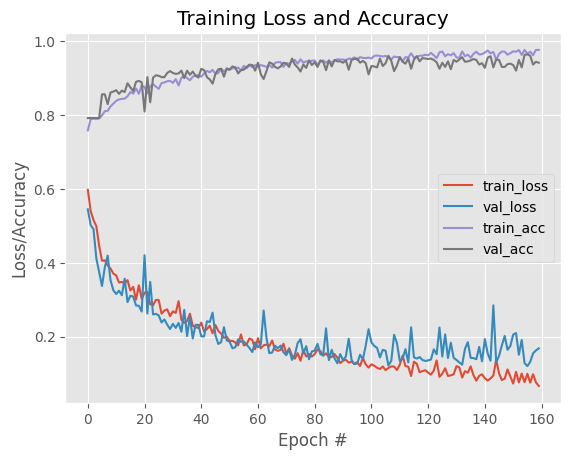

In [18]:
dl_utils.evaluate_model(scratch_original_model,x_test,y_test,False)
dl_utils.grafica_accuracy(scratch_original_model_results)

25/25 [==============================] - 0s 2ms/step
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97       629
         1.0       0.91      0.88      0.89       165

    accuracy                           0.96       794
   macro avg       0.94      0.93      0.93       794
weighted avg       0.96      0.96      0.96       794



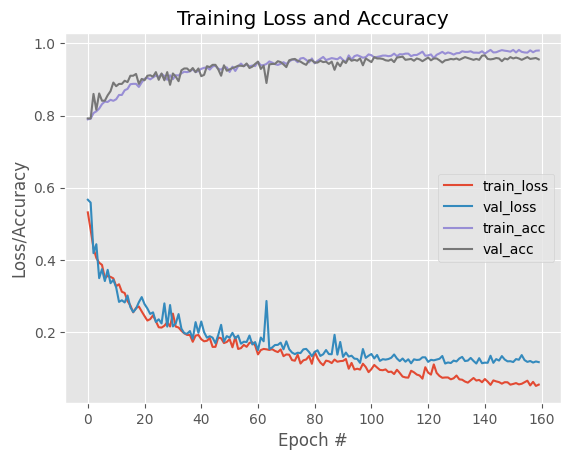

In [19]:
dl_utils.evaluate_model(scratch_modified_model,x_test,y_test,False)
dl_utils.grafica_accuracy(scratch_modified_model_results)

25/25 [==============================] - 0s 5ms/step
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97       629
         1.0       0.91      0.89      0.90       165

    accuracy                           0.96       794
   macro avg       0.94      0.93      0.94       794
weighted avg       0.96      0.96      0.96       794



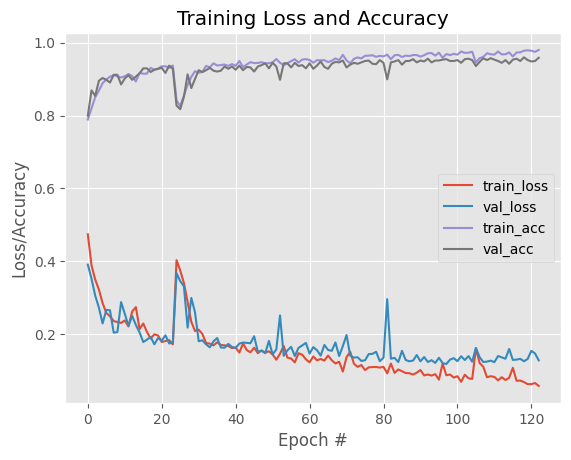

In [20]:
dl_utils.evaluate_model(vgg16,x_test,y_test,False)
dl_utils.grafica_accuracy(vgg16_results)

25/25 [==============================] - 0s 3ms/step
              precision    recall  f1-score   support

         0.0       0.96      0.94      0.95       629
         1.0       0.78      0.84      0.81       165

    accuracy                           0.92       794
   macro avg       0.87      0.89      0.88       794
weighted avg       0.92      0.92      0.92       794



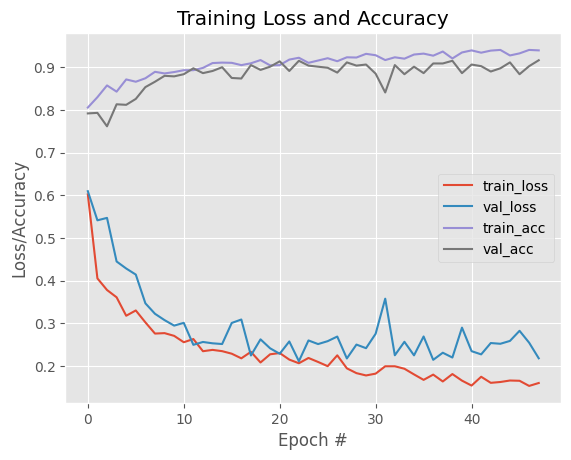

In [21]:
dl_utils.evaluate_model(mobile_net,x_test,y_test,False)
dl_utils.grafica_accuracy(mobile_net_results)

# Exploración del número de parámetros entrenables

In [22]:
import io
from contextlib import redirect_stdout
import re

In [23]:
def get_total_params(model):
    stream = io.StringIO()
    with redirect_stdout(stream):
        model.summary()
    summary_str = stream.getvalue()
    print(re.search(r"Total params.*\n.*\n.*",summary_str).group(0))

In [24]:
get_total_params(models.scratch_original_model(x_train.shape[1:]))

Total params: 116577 (455.38 KB)
Trainable params: 116577 (455.38 KB)
Non-trainable params: 0 (0.00 Byte)


In [25]:
get_total_params(models.scratch_modified_model(x_train.shape[1:]))

Total params: 1896513 (7.23 MB)
Trainable params: 1896513 (7.23 MB)
Non-trainable params: 0 (0.00 Byte)


In [26]:
get_total_params(models.mobilenet_model(x_train.shape[1:]))

Total params: 12648889 (48.25 MB)
Trainable params: 10482841 (39.99 MB)
Non-trainable params: 2166048 (8.26 MB)


In [27]:
get_total_params(models.vgg_16_model(x_train.shape[1:]))

Total params: 15433273 (58.87 MB)
Trainable params: 13699577 (52.26 MB)
Non-trainable params: 1733696 (6.61 MB)


In [28]:
get_total_params(models.mobilenet_model(x_train.shape[1:]))

Total params: 12648889 (48.25 MB)
Trainable params: 10482841 (39.99 MB)
Non-trainable params: 2166048 (8.26 MB)
